# Register single-subject macaque T1 images to NMTv2.0asym template using ANTs
The method presented here operates on images whose coordinate origin was reset to the location of the PMJ. This should help with initializing registration, since PMJ is close to the coordinate origin of the target template (NMTv2.0asym)

## Preparations

### Imports

In [2]:
import os
from registration_utils import register_linear, register_SyN, combine_transforms, overlay_contours

### Set up paths

In [6]:
# Path to template files (MODIFY if needed)
template_dir = os.path.join('/home/niko/MRI/', 'RheMAP', 'templates')
# NMTv2.0asym template (only brain, without surrounding tissue)
template = os.path.join(template_dir, 'NMT', 'NMT_v2.0_asym',
                        'NMT_v2.0_asym', 'NMT_v2.0_asym.nii.gz')

# Paths to 16 single-subject T1w images from PRIME-DE (MODIFY if needed)
root = "/home/niko/MRI/afids/single_macaca"
subjects_dir = os.path.join(root, "T1w_origin-PMJ")
# List of paths to individual images
subject_imgs = [
    os.path.join(subjects_dir, img)
    for img in os.listdir(subjects_dir)
    if img.endswith("PMJ.nii.gz")
]
subject_imgs.sort()
# List of subject IDs
subjects = [os.path.basename(img).split("_")[0] for img in subject_imgs]
print(f"Subjects: {subjects}")

# Set output directory (MODIFY if needed)
out_dir = os.path.join(root, "registered")

Subjects: ['sub-032104', 'sub-032105', 'sub-032107', 'sub-032108', 'sub-032198', 'sub-032199', 'sub-032201', 'sub-032203', 'sub-032209', 'sub-032210', 'sub-032211', 'sub-032212', 'sub-032213', 'sub-032214', 'sub-032215', 'sub-032216']


## Run registrations

### First perform a linear (affine, 12 DOF) registration

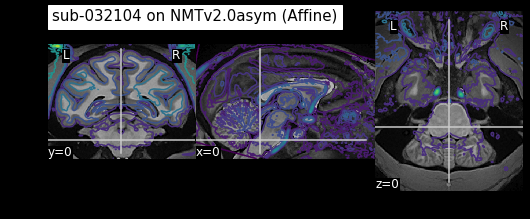

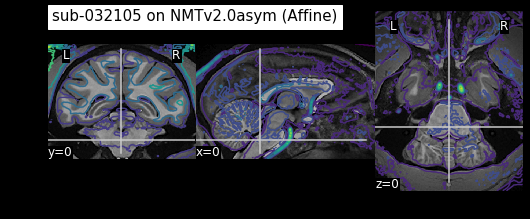

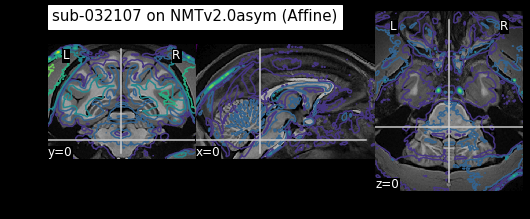

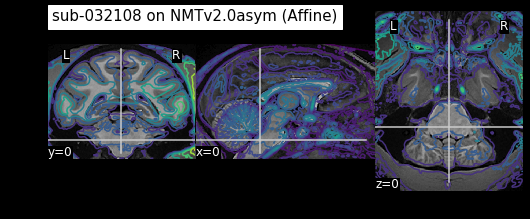

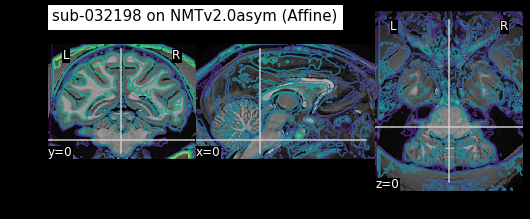

...

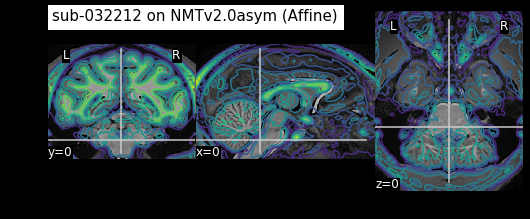

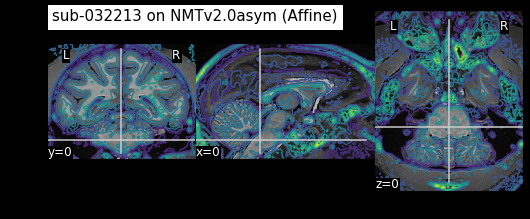

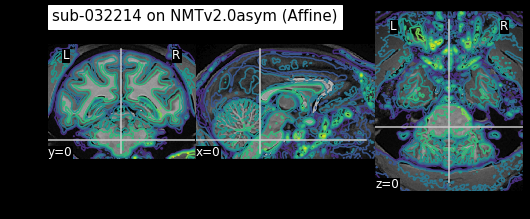

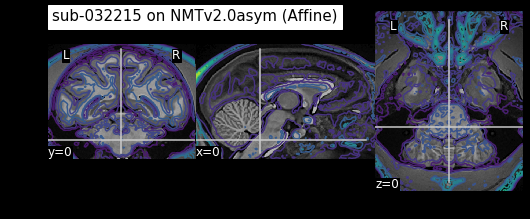

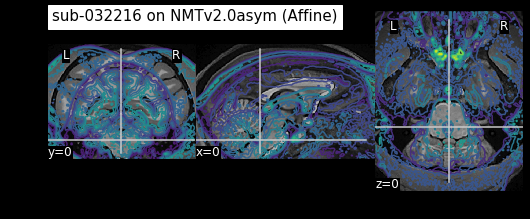

In [11]:
for i, img in enumerate(subject_imgs):
    subject = subjects[i]
    register_linear(
        img,
        template,
        f"{out_dir}/{subject}_to_NMTv2.0asym_",
        transform="Affine"
    )
    img_transformed = f"{out_dir}/{subject}_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed,
        plot_title=f"{subject} on NMTv2.0asym (Affine)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_Affine.png",
    )

### Follow up with non-linear (SyN) registration
The registration will start from the linearly aligned image

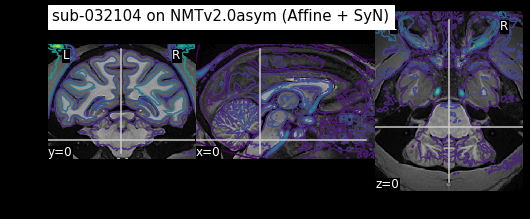

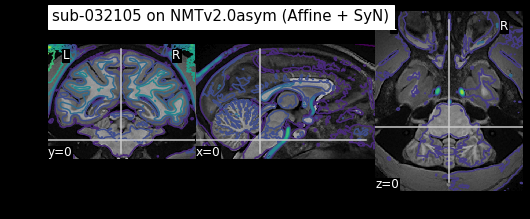

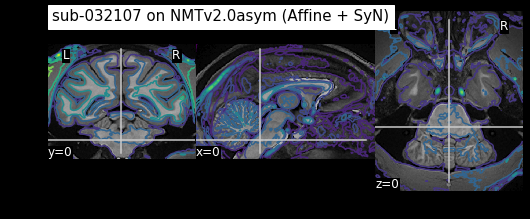

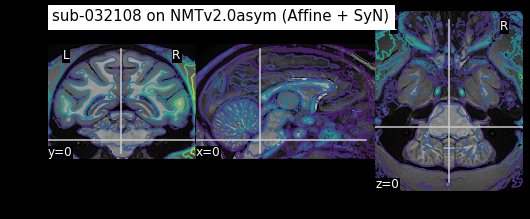

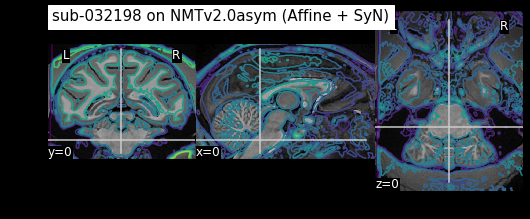

...

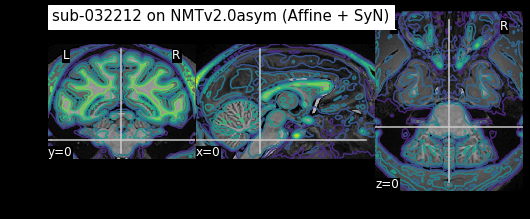

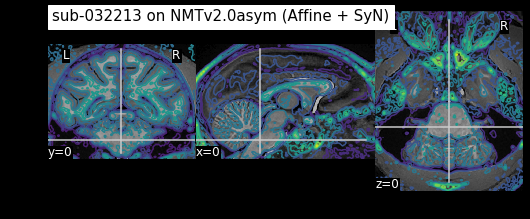

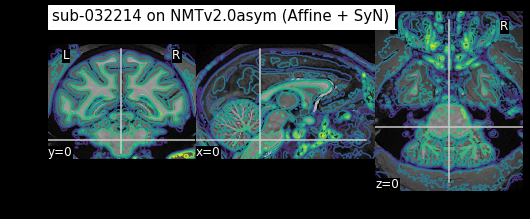

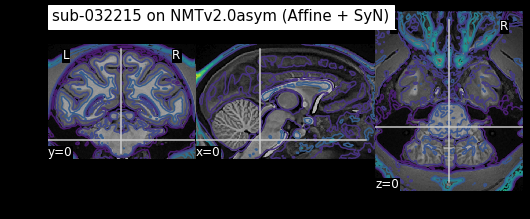

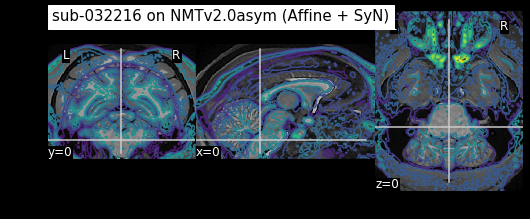

In [13]:
for i, img in enumerate(subject_imgs):
    subject = subjects[i]
    img_transformed_aff = f"{out_dir}/{subject}_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    register_SyN(
        img_transformed_aff,
        template,
        f"{out_dir}/{subject}_to_NMTv2.0asym_"
    )
    img_transformed_syn = f"{out_dir}/{subject}_to_NMTv2.0asym_SyN_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed_syn,
        plot_title=f"{subject} on NMTv2.0asym (Affine + SyN)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_SyN.png",
    )

## Combine linear and nonlinear transforms into composite warps
Two composite warps are output for each subject:
1. Forward: subject-to-template
2. Backward: template to subject

In [7]:
for i, img in enumerate(subject_imgs):
    subject = subjects[i]
    linear = os.path.join(out_dir, f"{subject}_to_NMTv2.0asym_Affine_0GenericAffine.mat")
    warp = os.path.join(out_dir, f"{subject}_to_NMTv2.0asym_SyN_1Warp.nii.gz")
    inv_warp = os.path.join(out_dir, f"{subject}_to_NMTv2.0asym_SyN_1InverseWarp.nii.gz")
    out_prefix = os.path.join(out_dir, f"{subject}_to_NMTv2.0asym_")
    combine_transforms(img, template, out_prefix, linear, warp, inv_warp)